# Кафе Москвы

# Оглавление:
* [Шаг 1. Загрузка данных. Изучение общейц информации](#1-bullet)
* [Шаг 2. Предобработка данных](#2-bullet)
* [Шаг 3. Анализ данных](#3-bullet)
* [3.1 Количество объектов общественного питания по категориям](#3-bullet)
* [3.2 Количество посадочных мест по категориям заведений](#4-bullet)
* [3.3 Cоотношение сетевых и несетевых заведений в датасете. Категории заведений которые чаще являются сетевыми.](#5-bullet)
* [3.4 Топ 15 сетевых заведений Москвы](#6-bullet)
* [3.5 Общее количество заведений и количество заведений каждой категории по районам Москвы.](#7-bullet)
* [3.6 Распределение средних рейтингов по категориям заведений.](#8-bullet)
* [3.7 Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.](#9-bullet)
* [3.8 Все заведения датасета на карте с помощью кластеров](#10-bullet)
* [3.9 Топ-15 улиц по количеству заведений](#11-bullet)
* [3.10 Улицы лишь с 1 объектом общепита](#12-bullet)
* [3.11 Ценовой индикатора района](#13-bullet)
* [Промежуточные выводы](#14-bullet)
* [Шаг 4. Детализируем исследование: открытие кофейни](#15-bullet)
* [Количество кофеен, распределение по районам](#15-bullet)
* [Рейтинг кофеен, распределение по районам](#16-bullet)
* [Средняя цена чашки капучино, распределение по районам](#17-bullet)
* [Среднее количество посадочных мест, распределение по районам.](#18-bullet)
* [Шаг 5. Презентации](#19-bullet)
* [Итоговые выводы](#19-bullet)

|  Название  |  Описание  |
| :----: |  :---- |
|  **Вводная информация**  | Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.|
|  **Основное задание проекта**  |  Подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.|
| **Датасет ** | /datasets/moscow_places.csv |

### Шаг 1. Загрузим данные и изучим общую информацию

In [1]:
#импортируем библиотеки
import pandas as pd
from datetime import datetime, timedelta
import seaborn as sns
from matplotlib import pyplot as plt
import numpy as np
from plotly import graph_objects as go
import plotly.express as px
import folium
import requests
from io import BytesIO

In [2]:
#загрузим данные
spreadsheet_id = '1dO9AhiwqUn_9lrjMg-oaFohA4hOF--zFPvWsuLqmmCE'
file_name = 'https://docs.google.com/spreadsheets/d/{}/export?format=csv'.format(spreadsheet_id)
r = requests.get(file_name)
df = pd.read_csv(BytesIO(r.content))

display(df.head(10))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0


In [4]:
#посмотрим общую информацию
print('Info')
print(df.info())

Info
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB
None


В датасете представлены данные о заведениях общепита г.Москвы, всего представлено 8406 заведений. 

Столбцы содержат строковые - тип object, дробные (float64) и целые (int64) числовые значения. 

Столбца содержащие категориальные значения: name - название заведения, category - тип(например, ресторан или кафе), address - адрес, district - район, hours - часы работы, price - уровень цен, avg_bill - средний чек (диапазон). 

Количественные значения: lat и lng - содержат числовые данные с координатами заведений (широту и долготу), rating - рейтинг, middle_avg_bill - средний чек(числом), middle_coffee_cup - средняя стоимость чашки кофе, chain - является ли заведение сетевым, seats - количество посадочных мест. 

### Шаг 2. Предобработка данных

In [6]:
#поиищем явные дубликаты
print('Дубликаты')
print('Всего {} дубликатов.'.format(df.duplicated().sum()))

Дубликаты
Всего 0 дубликатов.


In [7]:
#попробуем найти неявные дубликаты путем поиска заведений с одинаковыми координатами
#отобразим все строки
pd.set_option('display.max_rows', None)
#отобразим заведения имеющие одинаковые координаты
duplicateRows = df[df.duplicated(subset = ['lat', 'lng'], keep=False)].sort_values(by = ['lat'])
display(duplicateRows)
#подсчитаем, сколько всего заведений попало в выборку
duplicateRows['name'].count()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7638,Кофешефф,ресторан,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 08:30–21:00",55.607489,37.532367,4.3,NaN,NaN,NaN,NaN,0,60.0
7640,Крошка Картошка,быстрое питание,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 10:00–22:00",55.607489,37.532367,4.1,NaN,NaN,NaN,NaN,1,60.0
7787,Тануки,ресторан,"Москва, Липецкая улица, 2, корп. 8",Южный административный округ,"ежедневно, 10:00–05:00",55.608307,37.664941,4.3,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,120.0
7781,Ёрш,пиццерия,"Москва, Липецкая улица, 2, корп. 8",Южный административный округ,"ежедневно, 11:30–05:00",55.608307,37.664941,4.4,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,120.0
7767,За обе щёки,кафе,"Москва, Варшавское шоссе, вл132/2",Южный административный округ,"ежедневно, 09:00–21:00",55.620316,37.608922,3.6,NaN,NaN,NaN,NaN,1,NaN
7660,100лоффка,столовая,"Москва, Варшавское шоссе, вл132/2",Южный административный округ,пн-пт 09:00–17:30,55.620316,37.608922,4.4,низкие,Средний счёт:100–270 ₽,185.0,NaN,0,NaN
6598,Узбечка,столовая,"Москва, улица Академика Волгина, 2А",Юго-Западный административный округ,"ежедневно, 08:00–23:00",55.655107,37.521641,4.6,NaN,NaN,NaN,NaN,1,49.0
6809,Кафе Восток,кафе,"Москва, улица Академика Волгина, 2А",Юго-Западный административный округ,NaN,55.655107,37.521641,2.9,NaN,NaN,NaN,NaN,0,49.0
7407,Старый дворик,кафе,"Москва, улица Нижние Поля, 19Б, стр. 1",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.658424,37.737291,4.1,средние,Средний счёт:от 300 ₽,300.0,NaN,1,45.0
7362,Хинкальная,кафе,"Москва, улица Нижние Поля, 19Б, стр. 1",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.658424,37.737291,4.3,средние,Средний счёт:от 300 ₽,300.0,NaN,1,45.0


66

При подробном рассмотрении мы получили фрейм с 66 заведениями, координаты которых совпадают (в большинстве случаев одной точке на карте соответвсвуют 2 заведения, в паре случаев - 3), однако названия и категории заведений при этом отличаются, возможно ошибка при формировании базы (например произошла смена названия/концепции заведения, а данные о старом названии из базы не были удалены), либо заведения находятся на одной территории (например фудкорт ТЦ и т.п.) в ручном режиме, были определены 5 заведений, где речь идет об одном и то же объекте, но названия указаны на разных языках, выделим и удалим из базы посторяющиеся заведения по индексу.

In [8]:
#удалим из базы посторяющиеся заведения по индексу
df=df.drop(index=[6802, 5314, 1324, 2697, 1430]).reset_index(drop=True)

In [9]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [10]:
#посчитаем пропуски
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5086
avg_bill             4585
middle_avg_bill      5252
middle_coffee_cup    7866
chain                   0
seats                3609
dtype: int64

В основных, столбцах (наименование, адрес, район, координаты) пропусков нет, пропуски в остальных столбцах оставляем за неимением данных.

#### 2.1 Создаем столбец street с названиями улиц из столбца с адресом.

In [11]:
#создаем столбец street с названиями улиц из столбца с адресом
df['street']=df['address'].apply(lambda x: x.split(', ')[2] if x.split(', ')[1] == 'МКАД' else x.split(', ')[1])
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица


In [12]:
list(df['street'].unique())

['улица Дыбенко',
 'Клязьминская улица',
 'улица Маршала Федоренко',
 'Правобережная улица',
 'Ижорская улица',
 'Дмитровское шоссе',
 'Ангарская улица',
 'Левобережная улица',
 '80-й километр',
 'Базовская улица',
 'улица Бусиновская Горка',
 'Ленинградское шоссе',
 'Коровинское шоссе',
 'Ижорский проезд',
 'Прибрежный проезд',
 'Лобненская улица',
 'парк Левобережный',
 '78-й километр',
 'Угличская улица',
 'Абрамцевская улица',
 'ландшафтный заказник Лианозовский',
 'Череповецкая улица',
 'Алтуфьевское шоссе',
 'Лианозовский парк культуры и отдыха',
 'Дубнинская улица',
 'Илимская улица',
 'Шенкурский проезд',
 'Новгородская улица',
 'парк Алтуфьево',
 'улица Пришвина',
 '82-й километр',
 'бульвар Академика Ландау',
 'улица Лескова',
 'улица Плещеева',
 'Бибиревская улица',
 'Лианозовский проезд',
 'Челобитьевское шоссе',
 'Костромская улица',
 'Карельский бульвар',
 'Инженерная улица',
 'парк Ангарские пруды',
 'улица Софьи Ковалевской',
 'улица Корнейчука',
 'Проектируемый проезд 

In [13]:
#в данных встречаются аномалии, некоторые выделенные улицы, совпадаюи с наименование районов
df[df['street'] == 'Северо-Восточный административный округ']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
816,Угар молодости,"бар,паб","Москва, Северо-Восточный административный окру...",Северо-Восточный административный округ,NaN,55.855007,37.597675,4.0,NaN,NaN,NaN,NaN,0,NaN,Северо-Восточный административный округ
865,Park Point,кафе,"Москва, Северо-Восточный административный окру...",Северо-Восточный административный округ,"пн-пт 10:30–21:30; сб,вс 10:30–22:30",55.837165,37.612367,2.7,NaN,NaN,NaN,NaN,0,NaN,Северо-Восточный административный округ
934,Кофейня,кофейня,"Москва, Северо-Восточный административный окру...",Северо-Восточный административный округ,"ежедневно, 07:00–19:00",55.838051,37.667042,4.3,NaN,NaN,NaN,NaN,0,NaN,Северо-Восточный административный округ
1068,Coffeekaldi's,кофейня,"Москва, Северо-Восточный административный окру...",Северо-Восточный административный округ,"пн-пт 10:00–22:00; сб,вс 09:00–23:00",55.827131,37.634827,4.6,NaN,NaN,NaN,NaN,1,NaN,Северо-Восточный административный округ
1159,Едаки,быстрое питание,"Москва, Северо-Восточный административный окру...",Северо-Восточный административный округ,"ежедневно, 11:00–20:00",55.826663,37.617357,3.4,NaN,NaN,NaN,NaN,0,NaN,Северо-Восточный административный округ


In [14]:
#однако при проверке видно, что в данных просто отсутсвует наименование улицы
df['address'][816]

'Москва, Северо-Восточный административный округ, район Отрадное'

In [15]:
#в данных встречаются аномалии, некоторые выделенные улицы, совпадаюи с наименование районов
df_no_streets = df.query('street==district')
print('Всего аномалий - {}.'.format(df_no_streets['name'].count()))

Всего аномалий - 73.


In [16]:
print('Всего аномалий - {:.2%}.'.format(df_no_streets['name'].count()/df['name'].count()))

Всего аномалий - 0.87%.


В датасете всего менее 1% заведений не имеют в адресе название улицы, для целей исследования не критично, удалять или изменять данные не будем.

#### 2.2 Создаем столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7)

In [17]:
#проверим какие уникальные значения встречаются в столбце 'hours'
list(df['hours'].unique())

['ежедневно, 10:00–22:00',
 'пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00',
 'ежедневно, 09:00–22:00',
 'ежедневно, 10:00–23:00',
 'пн 15:00–04:00; вт-вс 15:00–05:00',
 'пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00',
 'ежедневно, 12:00–00:00',
 'ежедневно, круглосуточно',
 'ежедневно, 10:00–21:00',
 'вт-сб 09:00–18:00',
 'ежедневно, 08:00–22:00',
 'ежедневно, 13:00–00:00',
 'пн-пт 08:30–18:30; сб 10:00–20:00',
 'ежедневно, 09:00–21:00',
 'пн-пт 09:00–21:00',
 'пн-чт 11:00–22:00; пт,сб 11:00–23:00; вс 11:00–22:00',
 'пн-пт 08:00–22:00; сб,вс 10:00–22:00',
 'ежедневно, 10:00–19:00',
 'пн-пт 09:00–16:00',
 'ежедневно, 08:00–21:00',
 'ежедневно, 09:00–23:00',
 'ежедневно, 08:00–23:00',
 nan,
 'пн-пт 08:00–18:00',
 'пн-пт 09:00–19:00',
 'ежедневно, 11:00–00:00',
 'ежедневно, 09:00–02:00',
 'ежедневно, 12:00–23:00',
 'ежедневно, 12:00–03:00',
 'ежедневно, 16:00–06:00',
 'пн-чт 12:30–00:00; пт,сб 12:30–02:00; вс 12:30–00:00',
 'пн-сб 11:00–23:00; вс 12:00–23:00',
 'пн-пт 08:00

In [18]:
#приведем значения в столбце к нихнему регистру
df['hours']=df['hours'].str.lower()

In [19]:
#напишем функцию, которая будет присваивать значение True если заведение работает 24/7
def hour(row):
    try:
        if ('еж' in row) and ('кр' in row):
            return 'True'
        return False
    except:
        return 'False'

In [20]:
#Создаем столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7)
df['is_24/7'] = df['hours'].apply(hour)
#как видим, все работает корректно
df.head(15)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN,Ижорская улица,False
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0,Клязьминская улица,False
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0,Клязьминская улица,False
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0,Дмитровское шоссе,False
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0,Ангарская улица,False


Мы проверили данные на наличие дубликатов и пропусков, пропуски не заполняли, так как не имеем данных для их заполнения, явных дубликатов нет, есть несколько неявных 5 из которых удалили (были опечатки в названии, вспомогательные слова (типа "кафе") или же название было написано на латинице и на кирилице).

Добавили в датасет 2 новых столбца 'street' - с названием улиц, а также 'is_24/7' - со значениями True и False в зависимости от того работает ли заведение ежедневно и круглосуточно.

### Шаг 3. Анализ данных

#### 3.1 Количество объектов общественного питания по категориям

In [21]:
#сформируем сводную таблицу по категориям заведений
df_cat=df.pivot_table(index='category', values='name', aggfunc='count').sort_values(by='name', ascending=False).reset_index()
df_cat
#построим график
fig = px.bar(df_cat, x='category', y='name')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='Количество заведений по категориям',
                  xaxis_title="Категории",
                  yaxis_title="Количество заведений"
                 )
fig.show()

Как видно из графика, самые растпространенные типы заведений общепита в Москве, это кафе - 2376 шт, рестораны - 2040 и кофейни - 1413 шт, наименее часто встречающимися стали - столовая 315 и булочная 256 шт.

#### 3.2 Количество посадочных мест по категориям заведений

In [22]:
#перед построением графика, проанализируем распределение значений по столбцу seats
display(df['seats'].describe())
#также подсчитаем пропуски в столбце seats
print('Всего {} пропусков.'.format(df['seats'].isna().sum()))

count    4792.000000
mean      108.445117
std       122.850825
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

Всего 3609 пропусков.


Медианное значение 75 мест, но максимальное значение в 1288 мест выглядит неправдаподобным.

In [23]:
#выведем на экран заведения с максимальным количеством посадочных мест
df[df['seats']==1288]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
6514,DelonixCafe,ресторан,"Москва, проспект Вернадского, 94, корп. 1",Западный административный округ,"ежедневно, круглосуточно",55.652577,37.475730,4.1,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,0,1288.0,проспект Вернадского,True
6520,Ян Примус,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.657166,37.481519,4.5,выше среднего,Средний счёт:1500 ₽,1500.0,NaN,1,1288.0,проспект Вернадского,False
6570,Мюнгер,пиццерия,"Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.667505,37.491001,4.8,NaN,NaN,NaN,NaN,1,1288.0,проспект Вернадского,False
6637,One Price Coffee,кофейня,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,"ежедневно, 08:30–20:00",55.665129,37.478635,4.3,NaN,NaN,NaN,NaN,1,1288.0,проспект Вернадского,False
6654,ГудБар,"бар,паб","Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 11:00–23:00; сб,вс 13:00–23:00",55.667327,37.490601,4.1,средние,Средний счёт:700 ₽,700.0,NaN,0,1288.0,проспект Вернадского,False
6680,Пивной ресторан,"бар,паб","Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,NaN,55.657133,37.481508,4.5,NaN,NaN,NaN,NaN,0,1288.0,проспект Вернадского,False
6686,Японская кухня,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,NaN,55.657255,37.481547,4.4,NaN,NaN,NaN,NaN,1,1288.0,проспект Вернадского,False
6767,Точка,кафе,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,NaN,55.665634,37.477830,4.7,NaN,NaN,NaN,NaN,1,1288.0,проспект Вернадского,False
6802,Loft-cafe академия,кафе,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,пн-пт 09:00–20:00; сб 09:00–16:00,55.665142,37.478603,3.6,NaN,NaN,NaN,NaN,0,1288.0,проспект Вернадского,False
6803,Яндекс Лавка,ресторан,"Москва, проспект Вернадского, 51, стр. 1",Западный административный округ,"ежедневно, круглосуточно",55.672580,37.507753,4.0,NaN,NaN,NaN,NaN,1,1288.0,проспект Вернадского,True


Видимо в данных есть ошибка, так как насколько заведений из разных категорий, но, как не странно, расположенных на 1 улице (проспект Вернадского) имеют в столбце количесво мест цифру 1288, попробуем удалить выбросы.

In [24]:
#построим диаграмму размаха
fig = px.box(df, x='category', y='seats')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='Разброс количества посадочных мест по категориям',
                  xaxis_title="Категории",
                  yaxis_title="Количество посадочных мест"
                 )
fig.show()

Как видно из графика, одиночные выбросы по всем типам заведений начинаются примерно после 400 посадочных мест, сделаем срез данных по этой границе.

In [25]:
#сделаем срез, сохраним датасет в новую переменную
df_seats=df.query('seats<=400')
#проверим сколько заведений потеряно
df_seats['name'].count()

4671

In [26]:
#построим диаграмму размаха еще раз
fig = px.box(df_seats, x='category', y='seats')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='Разброс количества посадочных мест по категориям',
                  xaxis_title="Категории",
                  yaxis_title="Количество посадочных мест"
                 )
fig.show()

In [27]:
#посчитаем среднее количество посадочных мест для заведений разных категорий
df_seats=df_seats.groupby('category').agg({'seats': 'median'})\
.sort_values(by='seats', ascending=False).round()\
.astype('Int64').reset_index()
#display(df_seats)
#построим график
fig = px.bar(df_seats, x='seats', y='category', color='category')
fig.update_layout(title='Медианное количество посадочных мест по категориям',
                  xaxis_title="Количество посадочных мест",
                  yaxis_title="Категории",
                  showlegend=False
                 )
fig.show()

В более чем половине случаев количество посадочных мест не указано, кроме того, довольно много явно ошибочных данных. На основе имеющихся данных мы посчитали медианное количество посадочных мест в зависимости от категории заведения.

Так, обычно больше всего посадочных мест в категориях: ресторан, бар/паб, кофейня, меньше всего мест - в булочных.

#### 3.3 Cоотношение сетевых и несетевых заведений в датасете. Категории заведений которые чаще являются сетевыми. 

In [28]:
# готовим данные для графика
df_chain_1 = pd.DataFrame(df['chain'].value_counts()).reset_index()
# переименуем ячейки
df_chain_1.at[0,'index']='Несетевые'
df_chain_1.at[1,'index']='Сетевые'
display(df_chain_1)
# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=df_chain_1['index'], # указываем значения, которые появятся на метках сегментов
                             values=df_chain_1['chain'], # указываем данные, которые отобразятся на графике
                             pull = [0.1, 0])]) # добавляем аргумент, который выделит сегмент-лидер на графике
fig.update_layout(title='Cоотношение сетевых и несетевых заведений', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600
                  )
fig.show() # выводим график

,index,chain
0,Несетевые,5197
1,Сетевые,3204


In [29]:
# готовим данные для графика
df_cnain=df.pivot_table(index='category', columns='chain', values='name', aggfunc='count')
display(df_cnain)
# строим диаграмму
plot = go.Figure(data=[go.Bar(name='Несетевые',
                              x=df_cnain.index,
                              y=df_cnain[0],
                              text=df_cnain[0]
                             ),
                       go.Bar(name='Сетевые',
                              x=df_cnain.index,
                              y=df_cnain[1],
                              text=df_cnain[1])
                      ])

plot.update_layout(title='Количество заведений по категориям',
                  xaxis_title="Категории",
                  yaxis_title="Количество заведений"
                 )
plot.show()

chain,0,1
category,,
"бар,паб",596,169
булочная,99,157
быстрое питание,371,232
кафе,1597,779
кофейня,693,720
пиццерия,303,330
ресторан,1311,729
столовая,227,88


Сетевые и несетевые заведения в датасете разделились в отношении 38 и 62%, в пользу несетевых.

Больше всего сетевых заведений среди кафе, кофеен и ресторанов, меньше всего сетевых столовых. 

По соотношению сетевых к несетевым заведениям также выделяются кафе и ресторан, несетевых заведений примерно вдвое больше, скорее всего, это связано с тем, что от каже или ресторана клиенты ожидают отпределенную уникальность (концепция, кухня, оформление). Сетевые заведения преладают в таких категориях как: булочная, кофейня, пицерия.

#### 3.4 Топ 15 сетевых заведений Москвы

In [30]:
# готовим данные для графика
top15=df.query('chain==1').groupby(['name', 'category']).agg({'name': 'count'})\
.rename(columns={'name':'count'})\
.sort_values(by='count', ascending=False)\
.head(15).reset_index()
top15

,name,category,count
0,Шоколадница,кофейня,119
1,Домино'с Пицца,пиццерия,76
2,Додо Пицца,пиццерия,74
3,One Price Coffee,кофейня,71
4,Яндекс Лавка,ресторан,69
5,Cofix,кофейня,65
6,Prime,ресторан,49
7,КОФЕПОРТ,кофейня,42
8,Кулинарная лавка братьев Караваевых,кафе,39
9,Теремок,ресторан,36


In [31]:
# построим диаграмму
fig = px.bar(top15.sort_values(by='count', ascending=True), x='count', y='name')
fig.update_layout(title='Топ 15 сетевых заведений общепита Москвы',
                  xaxis_title="Количество точек сети",
                  yaxis_title="Наименование сети",
                  showlegend=False
                 )
fig.show()

In [32]:
# построим диаграмму с разбивкой по категориям
fig = px.bar(top15.sort_values(by='count', ascending=True), x='count', y='name', color='category')
fig.update_layout(title='Топ 15 сетевых заведений общепита Москвы с разбивкой по категориям',
                  xaxis_title="Количество точек сети",
                  yaxis_title="Наименование сети",
                  showlegend=True
                 )
fig.show()

В топ 15 сетей Москвы входят заведения из 5 категорий (всего категорий 8). Наиболее популярны сетевые кофейни, их в топ 15 ровно третья часть. По 3 заведения относятся к ресторанам и кафе. Также в топ 15 - 2 сетевых пицерии и 1 сеть булочных.

Среди представленных сетей, лично мне хорошо знакомы такие кофейни как: Кофемания, Шоколадница, Cofix; Пицерии: Домино'с Пицца и Додо Пицца. Яндекс Лавка представлена в Казани как служба доставки, а не как ресторан.

#### 3.5 Общее количество заведений и количество заведений каждой категории по районам Москвы.

In [33]:
# готовим данные для графика
df_distr_1=df.groupby('district').agg({'name': 'count'})\
.rename(columns={'name':'count'})\
.sort_values(by=['count'], ascending=False)
df_distr_1

,count
district,
Центральный административный округ,2242
Северный административный округ,898
Южный административный округ,892
Северо-Восточный административный округ,891
Западный административный округ,851
Восточный административный округ,796
Юго-Восточный административный округ,714
Юго-Западный административный округ,708
Северо-Западный административный округ,409


In [34]:
# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=df_distr_1.index, # указываем значения, которые появятся на метках сегментов
                             values=df_distr_1['count'], # указываем данные, которые отобразятся на графике
                             pull = [0.1, 0])]) # добавляем аргумент, который выделит сегмент-лидер на графике
fig.update_layout(title='Количество заведений общепита по районам Москвы', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600
                  )
fig.show()

In [35]:
# готовим данные для графика
df_distr=df.groupby(['district', 'category']).agg({'name': 'count'})\
.rename(columns={'name':'count'})\
.sort_values(by=['district', 'count'], ascending=False)
df_distr

count
district                                category              
Южный административный округ            кафе               264
                                        ресторан           202
                                        кофейня            131
                                        быстрое питание     85
                                        пиццерия            73
                                        бар,паб             68
                                        столовая            44
                                        булочная            25
Юго-Западный административный округ     кафе               237
                                        ресторан           168
                                        кофейня             96
                                        пиццерия            64
                                        быстрое питание     61
                                        бар,паб             38
                                        булочная            27
                                        столовая            17
Юго-Восточный административный округ    кафе               282
                                        ресторан           145
                                        кофейня             89
                                        быстрое питание     67
                                        пиццерия            55
                                        бар,паб             38
                                        столовая            25
                                        булочная            13
Центральный административный округ      ресторан           670
                                        кафе               464
                                        кофейня            428
                                        бар,паб            364
                                        пиццерия           113
                                        быстрое питание     87
                                        столовая            66
                                        булочная            50
Северо-Западный административный округ  кафе               115
                                        ресторан           109
                                        кофейня             62
                                        пиццерия            40
                                        быстрое питание     30
                                        бар,паб             23
                                        столовая            18
                                        булочная            12
Северо-Восточный административный округ кафе               269
                                        ресторан           182
                                        кофейня            159
                                        быстрое питание     82
                                        пиццерия            68
                                        бар,паб             63
                                        столовая            40
                                        булочная            28
Северный административный округ         кафе               235
                                        кофейня            193
                                        ресторан           187
                                        пиццерия            77
                                        бар,паб             68
                                        быстрое питание     58
                                        столовая            41
                                        булочная            39
Западный административный округ         кафе               239
                                        ресторан           218
                                        кофейня            150
                                        пиццерия            71
                                        быстрое питание     62
                                        бар,паб             50
                         

In [36]:
# строим диаграмму с сегментами
fig = px.bar(df_distr.sort_values(by='count', ascending=True).reset_index(), x='count', y='district', color='category')
fig.update_layout(title='Количество заведений общепита по районам Москвы с разбивкой по категориям',
                  xaxis_title="Количество заведений",
                  yaxis_title="Район",
                  showlegend=True
                 )
fig.show()

Как видно из графика, в датасете представлены данные по 9 административным округам Москвы.

Наиболее популярный район: ЦАО (Центральный административный округ), при разбивке по категориям видим, что самая популярная категория заведений в этом районе - рестораны (670 шт). Также сопостовимое количество заведений (364-463) в категориях: кафе, кофейня, бар/паб. Меньше всего представлено булочных и столовых (50 и 66 соответственно).

Наименее популярный среди рестораторов район Москвы - Северо-Западный административный округ (СЗАО) - всего 409 заведений общепита. Самыми популярными также становятся кафе и рестораны (115,109 соответственно), булочных и столовых - 12 и 18 соответственно.

В целом необходимо отметить, что кроме района ЦАО, во свех остальных районах наиболее популярная категория заведений - кафе.

#### 3.6 Распределение средних рейтингов по категориям заведений.

In [37]:
# готовим данные для графика
df_rating=df.groupby(['category']).agg({'rating': 'mean'})\
.rename(columns={'rating':'mean_rating'})\
.sort_values(by='mean_rating', ascending=False)
df_rating
# строим диаграмму
fig = px.bar(df_rating.sort_values(by='mean_rating', ascending=True), x='mean_rating')
fig.update_layout(title='Усредненные рейтинги заведений по категориям',
                  xaxis_title="Рейтинг",
                  yaxis_title="Категория",
                  showlegend=False,
                  xaxis=dict(range=[4, 4.4])
                 )
fig.show()

Средние рейтинги заведений в разбивке по типу, практически не отличаются. Наиболее высокие средние рейтинги имеют - бары (4,4), наиболее низкие - фаст-фуд (4).

#### 3.7 Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

In [38]:
rating_df = df.groupby('district', as_index=False)['rating'].agg('median')
rating_df

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [39]:
# подключаем модуль для работы с JSON-форматом
import json

# читаем файл и сохраняем в переменной
try:
    with open('/datasets/admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)
except:
    with open("C:/Users/zarus/Downloads/admin_level_geomap.geojson", 'r') as f:
        geo_json = json.load(f)
    
print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [40]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Заведения с самым высоким медианным рейтингом сосредоточены в ЦАО, самый низкий медианный рейтинг у Северо-Восточного и Юго-Восточного административных округов. Остальный районы имеют примерно равный мидианный рейтинг заведений общепита.

#### 3.8 Все заведения датасета на карте с помощью кластеров

In [41]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

#### 3.9 Топ-15 улиц по количеству заведений.

In [42]:
#сгруппируем данные, выделим топ 15 улиц по количеству заведений
top15_street=df.groupby(['street']).agg({'name': 'count'})\
.rename(columns={'name':'count'})\
.sort_values(by='count', ascending=False)\
.head(15).reset_index()
#преобразуем в список
l=top15_street['street'].to_list()
#сделаем срез данных, что бы в фрейме остались только топ 15 улиц
top15_st=df.query('street==@l')
#снова сгруппируем по улице и категории
top15_st=top15_st.groupby(['street', 'category']).agg({'name': 'count'})\
.rename(columns={'name':'count'})\
.sort_values(by=['street', 'count'], ascending=False)\
.reset_index()
top15_st
# добавим столбец с общим количеством заведений для каждой улице
t15st=top15_st.merge(top15_street, on='street', how='inner')
t15st.sort_values(by='count_y', ascending=False)

,street,category,count_x,count_y
13,проспект Мира,кафе,53,184
20,проспект Мира,столовая,2,184
19,проспект Мира,булочная,4,184
18,проспект Мира,пиццерия,11,184
17,проспект Мира,"бар,паб",12,184
16,проспект Мира,быстрое питание,21,184
15,проспект Мира,кофейня,36,184
14,проспект Мира,ресторан,45,184
42,Профсоюзная улица,булочная,4,122
43,Профсоюзная улица,столовая,3,122


In [43]:
fig = px.bar(top15_street.sort_values(by='count', ascending=True), x='count', y='street')
fig.update_layout(title='Топ 15 улиц Москвы по количеству заведений общепита',
                  xaxis_title="Количество заведений",
                  yaxis_title="Улица",
                  showlegend=False
                 )
fig.show()

In [44]:

fig = px.bar(t15st.sort_values(by='count_y', ascending=False), x='count_x', y='street', color='category')
fig.update_layout(title='Топ 15 улиц Москвы по количеству заведений общепита',
                  xaxis_title="Количество заведений",
                  yaxis_title="Улица",
                  showlegend=True
                 )
fig.show()

Самая популярная среди рестораторов улица Москвы - Проспект Мира - всего 184 заведения. Самая широкопредставленная категория - кафе (53), также довольно много ресторанов (45) и кофеен (36).

#### 3.10 Улицы лишь с 1 объектом общепита

In [45]:
#сгруппируем
only1_st=df.groupby('street').agg({'name': 'count'})\
.rename(columns={'name':'count'})\
.sort_values(by='count', ascending=True)\
.reset_index()
#сделаем срез, улицы только с 1 заведением
only1_st=only1_st.query('count==1')
print('Всего улиц с 1 заведением - {}.'.format(only1_st['count'].sum()))

Всего улиц с 1 заведением - 469.


In [46]:
#преобразуем в список для среза
l1=only1_st['street'].to_list()
#сделаем срез, улицы только с 1 заведением
only1_st=df.query('street==@l1')
#снова сгруппируем по улице и категории
only1_st=only1_st.groupby(['category']).agg({'name': 'count'})\
.sort_values(by='name', ascending=False).reset_index()
only1_st

,category,name
0,кафе,168
1,ресторан,93
2,кофейня,87
3,"бар,паб",39
4,столовая,36
5,быстрое питание,23
6,пиццерия,15
7,булочная,8


In [47]:
fig = go.Figure(data=[go.Pie(labels=only1_st['category'], # указываем значения, которые появятся на метках сегментов
                             values=only1_st['name'], # указываем данные, которые отобразятся на графике
                             pull = [0.1, 0])]) # добавляем аргумент, который выделит сегмент-лидер на графике
fig.update_layout(title='Распределение по категориям "одиноких" заведений', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600
                  )
fig.show()

Всего в датасете 469 улиц, на которых расположено лишь по 1 заведению. Среди таких заведений преобладают кафе - более 35%, реже всего можно встретить одинокую булочную - 1,7%.

#### 3.11 Ценовой индикатора района.

In [48]:
avg_bill_df = df.groupby('district', as_index=False)['middle_avg_bill'].agg('median')
avg_bill_df.sort_values(by='middle_avg_bill', ascending=False)

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [49]:
# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_df,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный средний чек в заведениях по районам',
).add_to(m)

# выводим карту
m

Медианные значения среднего чека варьируются от 450 до 1000 руб. Так наиболее дорогие районы это ЦАО и ЗАО (Западный административный округ) - 1000 руб., самый низкий средний чек в Юго-Восточном административном округе - 450 руб.

#### Промежуточные выводы
- Всего в датасете представлены данные о 8401 заведениях общепита.
- Самые растпространенные типы заведений общепита в Москве, это кафе - 2376 шт, рестораны - 2040 и кофейни - 1413 шт.
- В более чем половине случаев количество посадочных мест не указано, медианное количество посадочных мест в зависимости от типа заведения колеблиться от 50 до 83 мест. (больше всего посадочных мест в категориях: ресторан, бар/паб, кофейня, меньше всего мест - в булочных).
- В Москве представлено больше несетевых заведений общепита 62% по отношению к 38% сетевых, однако распределение по типам заведений неравномерное. Больше всего сетевых заведений среди кафе, кофеен и ресторанов, меньше всего сетевых столовых.
- Наиболее популярный район: ЦАО (Центральный административный округ)(порядка 27% всех заведений расположены в данном районе), при разбивке по категориям видим, что самая популярная категория заведений в этом районе - рестораны (670 шт). 
- Наименее популярный среди рестораторов район Москвы - Северо-Западный административный округ (СЗАО) - всего 409 заведений  общепита (менее 5%). Остальные районы примерно равны между собой по количеству заведений.
- Средние рейтинги заведений в разбивке по типу, практически не отличаются расположены в диапазоне 4.1-4.4 балла.
- Заведения с самыми высокими рейтингами сосредоточены в ЦАО, самые низкие медианные рейтинги у заведений из Северо-Восточного и Юго-Восточного административных округов.
- Самая популярная среди рестораторов улица Москвы - Проспект Мира - всего 184 заведения. Больше всего - кафе (53), также в топе рестораны (45) и кофейни (36).
- Медианные значения среднего чека варьируются от 450 до 1000 руб. Так наиболее дорогие районы это ЦАО и ЗАО (Западный административный округ) - 1000 руб., самый низкий средний чек в Юго-Восточном административном округе - 450 руб.

### Шаг 4

#### Количество кофеен,  распределение по районам.

In [50]:
#сделаем срез, выделим кофейни в отдельный датасет
coffee=df.query('category=="кофейня"')
print('Всего кофеен - {}.'.format(coffee['name'].count()))

Всего кофеен - 1413.


In [51]:
# готовим данные для графика, посчитаем количество кофеен по районам, 
coffee_dist=coffee.pivot_table(index='district', columns='chain', values='name', aggfunc='count')
coffee_dist['total']=coffee_dist[0]+coffee_dist[1]
coffee_dist = coffee_dist.sort_values(by='total', ascending=False)

display(coffee_dist)

chain,0,1,total
district,,,
Центральный административный округ,207,221,428
Северный административный округ,96,97,193
Северо-Восточный административный округ,80,79,159
Западный административный округ,57,93,150
Южный административный округ,65,66,131
Восточный административный округ,54,51,105
Юго-Западный административный округ,46,50,96
Юго-Восточный административный округ,60,29,89
Северо-Западный административный округ,28,34,62


In [52]:
# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=coffee_dist.index, # указываем значения, которые появятся на метках сегментов
                             values=coffee_dist['total'], # указываем данные, которые отобразятся на графике
                             pull = [0.1, 0])]) # добавляем аргумент, который выделит сегмент-лидер на графике
fig.update_layout(title='Количество кофеен по районам', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600
                  )
fig.show() # выводим график

In [53]:
# проанализируем соотношение сетевых и несетевых кофеен 
# строим диаграмму с сегментами
plot = go.Figure(data=[go.Bar(name='Несетевые',
                              x=coffee_dist.index,
                              y=coffee_dist[0],
                              text=coffee_dist[0]
                             ),
                       go.Bar(name='Сетевые',
                              x=coffee_dist.index,
                              y=coffee_dist[1],
                              text=coffee_dist[1])
                      ])

plot.update_layout(title='Количество сетевых и несетевых кофеен по районам',
                  xaxis_title="Районы",
                  yaxis_title="Количество кофеен"
                 )
plot.show()

In [54]:
# подготовим данные
coffee_dist1 = coffee_dist.reset_index()
# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_dist1,
    columns=['district', 'total'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Количество кофеен',
).add_to(m)

# выводим карту
m

Согласно представленным данным в Москве всего 1413 кофеен. Распределены по районам неравномерно. Большинство кофеен (30%) находятся в ЦАО. Меньше всего кофеен в Северо-Западном округе (менее 5%).

Кофейни по районам в разрезе сетевых и несетевых разпределены достаточно равномерно, практически везде сетевых и несетевых кофеен равное количество либо небольшое преимущество имеют сети. Исключение:Западный округ, сетевых кофеен почти в 1,6 раз больше чем несетевых. Юго-Восточный округ -  несетевых кофеен в 2 раза больше чем сетевых. 

In [55]:
# попробуем оценить особенности размещения кофеен
# построим интерактивную карту с метками кофеен
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_coffee_cup']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee.apply(create_clusters, axis=1)

# выводим карту
m

In [56]:
#проверим, есть ли круглосуточные кофейни
print('Всего круглосуточных кофеен - {}.'.format(coffee[coffee['is_24/7']==True]['name'].count()))

Всего круглосуточных кофеен - 0.


#### Рейтинг кофеен,  распределение по районам.

In [57]:
# готовим данные для графика
coffee_rating=coffee.groupby(['district']).agg({'rating': 'mean'})\
.rename(columns={'rating':'mean_rating'})\
.sort_values(by='mean_rating', ascending=False).round(2).reset_index()
display(coffee_rating)
# строим диаграмму
fig = px.bar(coffee_rating.sort_values(by='mean_rating', ascending=True), x='mean_rating', y='district')
fig.update_layout(title='Усредненные рейтинги кофеен по районам',
                  xaxis_title="Средний рейтинг",
                  yaxis_title="Район",
                  showlegend=True,
                  xaxis=dict(range=[4, 4.4])
                 )
fig.show()

,district,mean_rating
0,Центральный административный округ,4.34
1,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
3,Юго-Западный административный округ,4.28
4,Восточный административный округ,4.28
5,Южный административный округ,4.23
6,Юго-Восточный административный округ,4.23
7,Северо-Восточный административный округ,4.22
8,Западный административный округ,4.20


In [58]:
# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_rating,
    columns=['district', 'mean_rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

# выводим карту
m

Средний рейтинг кофеен достаточно предсказуем, лучший район от худшего отличается на десятые доли пункта. Как и общий рейтинг по всем заведениям общепита наиболее высокий рейтинг кофеен в ЦАО.
Кроме того положительно выделяется Северо-Западный округ. А Западный округ напротив имеет самый низкий средний рейтинг кофеен из всех.

#### Средняя цена чашки капучино,  распределение по районам.

In [59]:
middle_coffee_cup_no_chain = coffee.query('chain==0').groupby('district', as_index=False)['middle_coffee_cup'].agg('median')
middle_coffee_cup_no_chain.sort_values(by='middle_coffee_cup', ascending=False)

,district,middle_coffee_cup
5,Центральный административный округ,195.0
7,Юго-Западный административный округ,190.5
1,Западный административный округ,170.0
8,Южный административный округ,170.0
2,Северный административный округ,165.0
4,Северо-Западный административный округ,165.0
3,Северо-Восточный административный округ,162.5
6,Юго-Восточный административный округ,150.0
0,Восточный административный округ,135.0


In [60]:
# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_coffee_cup_no_chain,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианная стоимость чашки кофе',
).add_to(m)

# выводим карту
m

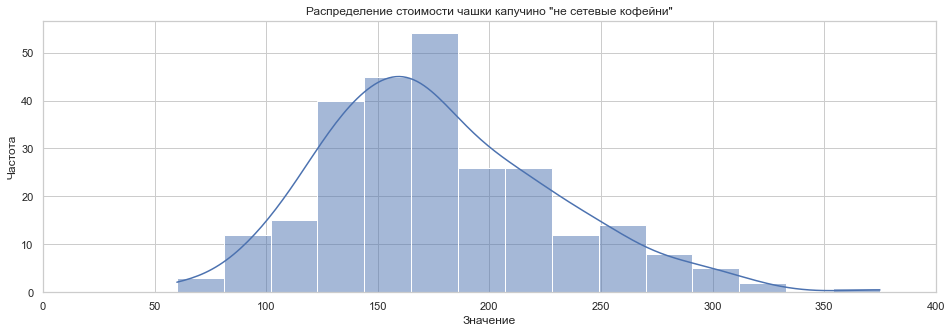

In [61]:
no_chain_coffee_cup = coffee.query('chain==0')

sns.set(style='dark')
sns.set_style("whitegrid")
plt.figure(figsize=(16,5))
# строим гистограмму для столбца total_income, добавив график кривой KDE
sns.histplot(x='middle_coffee_cup', data=no_chain_coffee_cup, kde=True)
# ограничиваем ось X для наглядности
plt.xlim(0, 400)
# указываем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение стоимости чашки капучино "не сетевые кофейни"')
plt.xlabel('Значение')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

In [62]:
middle_coffee_cup_chain = coffee.query('chain==1').groupby('district', as_index=False)['middle_coffee_cup'].agg('median')
middle_coffee_cup_chain.sort_values(by='middle_coffee_cup', ascending=False)

,district,middle_coffee_cup
1,Западный административный округ,222.5
7,Юго-Западный административный округ,199.5
5,Центральный административный округ,180.0
4,Северо-Западный административный округ,172.0
3,Северо-Восточный административный округ,162.0
2,Северный административный округ,140.0
0,Восточный административный округ,135.0
6,Юго-Восточный административный округ,130.0
8,Южный административный округ,109.5


In [63]:
# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_coffee_cup_chain,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианная стоимость чашки кофе',
).add_to(m)

# выводим карту
m

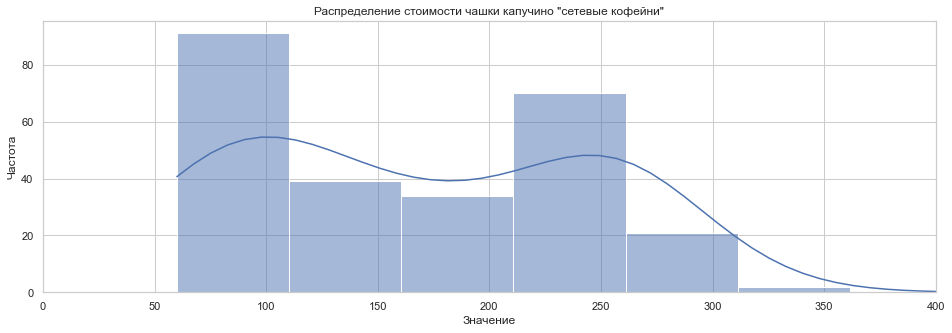

In [64]:
chain_coffee_cup = coffee.query('chain==1')

sns.set(style='dark')
sns.set_style("whitegrid")
plt.figure(figsize=(16,5))
# строим гистограмму для столбца total_income, добавив график кривой KDE
sns.histplot(x='middle_coffee_cup', data=chain_coffee_cup, kde=True)
# ограничиваем ось X для наглядности
plt.xlim(0, 400)
# указываем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение стоимости чашки капучино "сетевые кофейни"')
plt.xlabel('Значение')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

Средняя цена чашки капучино отличается сетевых и несетевых кофеен, так для несетевых кофеен самая популярная цена 160-180 руб., для сетевых - 60-110 руб.

Самая высокая медианная цена чашки капучино: сетевые - Западный административный округ (222 руб.), несетевые - Центральный административный округ (195 руб.)

Самая низкая медианная цена чашки капучино: сетевые - Южный административный округ (110 руб.), несетевые - Восточный административный округ (135 руб.)

#### Среднее количество посадочных мест,  распределение по районам.

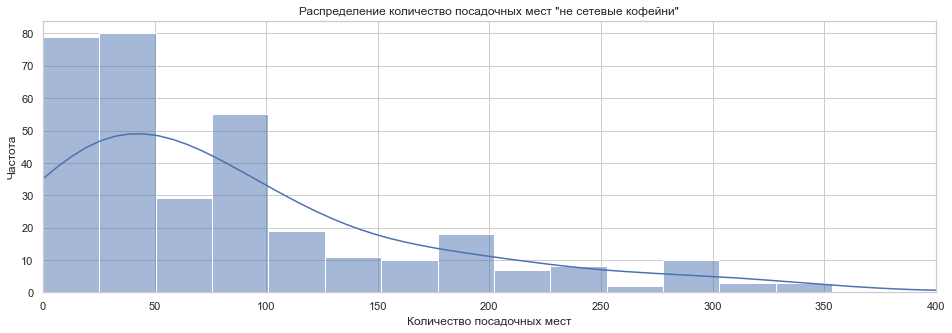

In [65]:
no_chain_coffee_cup = coffee.query('chain==0')

sns.set(style='dark')
sns.set_style("whitegrid")
plt.figure(figsize=(16,5))
# строим гистограмму для столбца total_income, добавив график кривой KDE
sns.histplot(x='seats', data=no_chain_coffee_cup, kde=True)
# ограничиваем ось X для наглядности
plt.xlim(0, 400)
# указываем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение количество посадочных мест "не сетевые кофейни"')
plt.xlabel('Количество посадочных мест')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

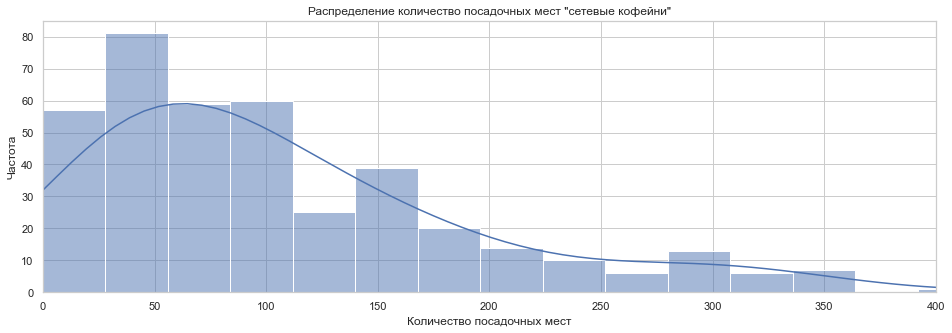

In [66]:
chain_coffee_cup = coffee.query('chain==1')

sns.set(style='dark')
sns.set_style("whitegrid")
plt.figure(figsize=(16,5))
# строим гистограмму для столбца total_income, добавив график кривой KDE
sns.histplot(x='seats', data=chain_coffee_cup, kde=True)
# ограничиваем ось X для наглядности
plt.xlim(0, 400)
# указываем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение количество посадочных мест "сетевые кофейни"')
plt.xlabel('Количество посадочных мест')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

Количество посадочных мест в сетевых и несетевых заведениях отличается не так сильно. Чаще всего в кофейне от 30 до 50 мест. В целом кофейни с  более чем 100 посадочными местами встречаются довольно редко.

### Шаг 5. Презентация

Ссылка на скачивание презентации
https://disk.yandex.ru/d/yhZpa4TZFRnQXQ

### Итоговые выводы

- В датасете представлены данные о заведениях общепита г.Москвы, всего представлено 8406 заведений.
- Мы проверили данные на наличие дубликатов и пропусков, пропуски не заполняли, явных дубликатов нет, есть несколько неявных (5) - удалили.
- Добавили в датасет 2 новых столбца 'street' - с названием улиц, а также 'is_24/7' - со значениями True и False в зависимости от того работает ли заведение ежедневно и круглосуточно.
- Самые растпространенные типы заведений общепита в Москве, это кафе - 2376 шт, рестораны - 2040 и кофейни - 1413 шт.
- В более чем половине случаев количество посадочных мест не указано, медианное количество посадочных мест в зависимости от типа заведения колеблиться от 50 до 83 мест. (больше всего посадочных мест в категориях: ресторан, бар/паб, кофейня, меньше всего мест - в булочных).
- В Москве представлено больше несетевых заведений общепита 62% по отношению к 38% сетевых, однако распределение по типам заведений неравномерное. Больше всего сетевых заведений среди кафе, кофеен и ресторанов, меньше всего сетевых столовых.
- Наиболее популярный район: ЦАО (Центральный административный округ)(порядка 27% всех заведений расположены в данном районе), при разбивке по категориям видим, что самая популярная категория заведений в этом районе - рестораны (670 шт). 
- Наименее популярный среди рестораторов район Москвы - Северо-Западный административный округ (СЗАО) - всего 409 заведений  общепита (менее 5%). Остальные районы примерно равны между собой по количеству заведений.
- Средние рейтинги заведений в разбивке по типу, практически не отличаются расположены в диапазоне 4.1-4.4 балла.
- Заведения с самыми высокими рейтингами сосредоточены в ЦАО, самые низкие медианные рейтинги у заведений из Северо-Восточного и Юго-Восточного административных округов.
- Самая популярная среди рестораторов улица Москвы - Проспект Мира - всего 184 заведения. Больше всего - кафе (53), также в топе рестораны (45) и кофейни (36).
- Медианные значения среднего чека варьируются от 450 до 1000 руб. Так наиболее дорогие районы это ЦАО и ЗАО (Западный административный округ) - 1000 руб., самый низкий средний чек в Юго-Восточном административном округе - 450 руб.

Немного подробнее о кофейнях:

- Согласно представленным данным в Москве всего 1413 кофеен. Распределены по районам неравномерно. Большинство кофеен (30%) находятся в ЦАО. Меньше всего кофеен в Северо-Западном округе (менее 5%).
- Кофейни по районам в разрезе сетевых и несетевых разпределены достаточно равномерно, практически везде сетевых и несетевых кофеен равное количество либо небольшое преимущество имеют сети.
- Средняя цена чашки капучино отличается для сетевых и несетевых кофеен, так для несетевых кофеен самая популярная цена 160-180 руб., для сетевых - 60-110 руб.
- Самая высокая медианная цена чашки капучино: сетевые - Западный административный округ (222 руб.), несетевые - Центральный административный округ (195 руб.)
- Самая низкая медианная цена чашки капучино: сетевые - Южный административный округ (110 руб.), несетевые - Восточный административный округ (135 руб.)
- Количество посадочных мест в сетевых и несетевых заведениях отличается не сильно. Чаще всего в кофейне от 30 до 50 мест.